In [14]:
from PIL import Image
import requests
import torch
from transformers import CLIPProcessor, CLIPModel
from torchvision.datasets import ImageFolder
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from tqdm import tqdm
import random
from util import *
import splice
# Path to your images
test_images_path = '../data/imagenet/val/'
import open_clip
import os

# Load the dataset
dataset = datasets.ImageFolder(root=test_images_path)

# Create a DataLoader to load the images in batches
dataloader = DataLoader(dataset, batch_size=128, shuffle=False, num_workers=4)
random.seed(1234)

## load models and pre-computed embeddings

In [2]:
model, _, preprocess = open_clip.create_model_and_transforms('ViT-B-32', pretrained='openai')
tokenizer = open_clip.get_tokenizer('ViT-B-32')
device = "cuda"

In [32]:
image_features = torch.load('/home/jitian/embedding_hc/computed_embeddings/image_features_vit-b-32.pt')
text_features = torch.load('../computed_embeddings/text_features_general_descriptions_vit-b-32.pt')

## Concept decomposition

In [33]:
k = 50
L = glaplacian(torch.tensor(image_features))
U, S, Vt = randomized_svd(L, n_components=k)
S_diag = np.diag(S) 
Z = U @ S_diag
Z_rotated, Rz = varimax_with_rotation(Z)
sign_Z = np.diag(np.where(np.mean(Z_rotated**3, axis=0) >= 0, 1, -1))
Z_hat = Z_rotated @ sign_Z
Y_hat = sign_Z @ Rz.T @ Vt

/tmp/ipykernel_65966/1164040439.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  L = glaplacian(torch.tensor(image_features))


In [34]:
Z_hat_imgs = Z_hat
Y_hat_imgs = Y_hat

In [35]:
wnid_to_class = {}

# Open the text file containing the mappings
with open('../data/imagenet/map_clsloc.txt', 'r') as file:
    # Read the file line by line
    for line in file:
        # Split the line into wnid, index, and class name
        parts = line.strip().split(' ')
        wnid = parts[0]
        class_name = ' '.join(parts[2:])  # Join the remaining parts to form the class name
        # Add the mapping to the dictionary
        wnid_to_class[wnid] = class_name 
        
transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor()
])
test_images_path = '../data/imagenet/val/'  
raw_dataset = ImageFolder(root=test_images_path, transform=transform)

In [36]:
file_path = '~/embedding_hc/imgs/clip/vit_b/ortho_concept_512d/'
file_path = os.path.expanduser(file_path)
plot_top_pos_images_per_cluster(Z_hat_imgs, raw_dataset, wnid_to_class, file_path, n=9, nrows=3, ncols=3)

In [37]:
concepts_file = '~/embedding_hc/clip_text_span/text_descriptions/image_descriptions_per_class.txt'
concepts_file = os.path.expanduser(concepts_file)
concepts = []
with open(concepts_file, "r") as f:
    lines = f.readlines()
    for line in lines:
        line = line.strip()
        concepts.append(line)

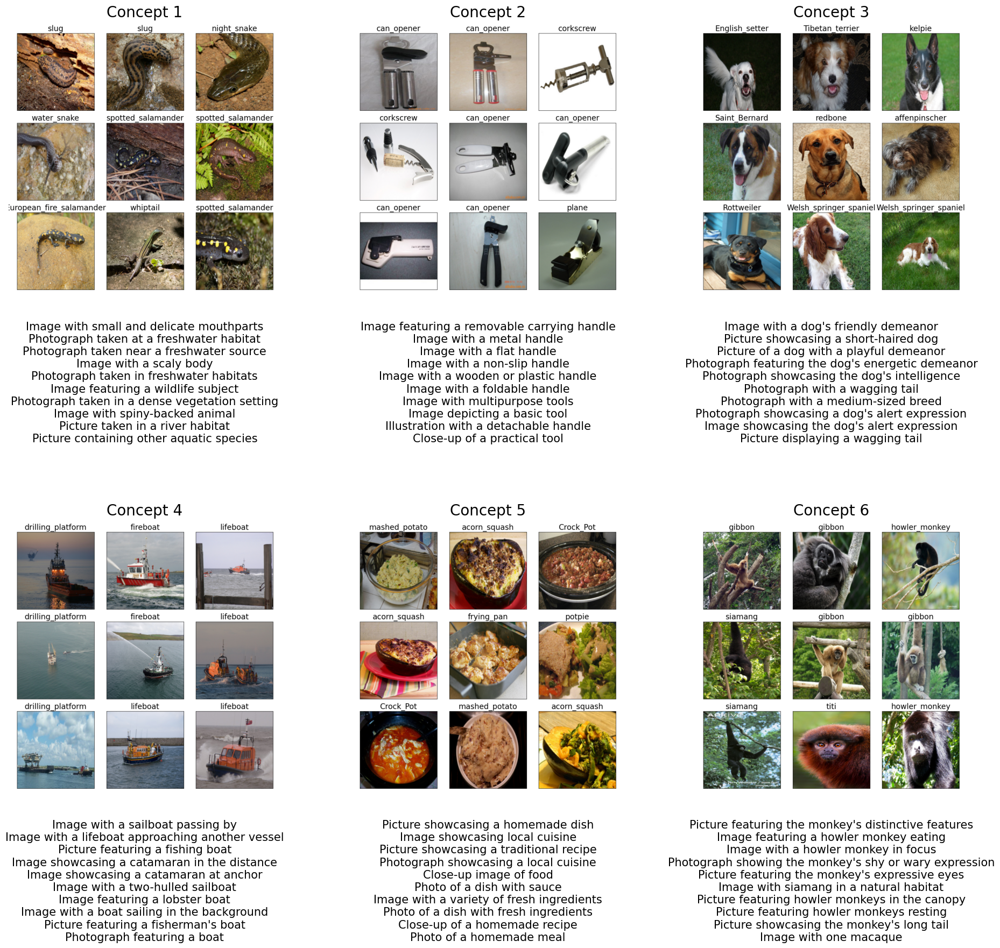

In [38]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# Project the text embeddings
projected_text_embedding = text_features @ Y_hat.T

# Get top positive and negative texts
top_texts, txt_scores = get_top_n_elements(csr_matrix(projected_text_embedding), n=10, axis=0)
top_neg_texts, neg_txt_scores = get_top_n_elements(csr_matrix(-projected_text_embedding), n=10, axis=0)

# Prepare the figure with a grid layout
fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(20, 20))  # Adjust the size as needed
axs = axs.flatten()  # Flatten the array to simplify indexing

# Loop over the range of clusters/images you have
for i in range(6):
    image_path = file_path + 'cluster_' + str(i + 1) + '.png'
    image = Image.open(image_path).convert("RGB")

    # Display image
    axs[i].imshow(np.array(image))
    axs[i].axis('off')  # Turn off axis

    # Create text description combining top texts
    # description = "Top positive:\n" + "\n".join([lines[txt] for txt in top_texts[i]]) + \
    #               "\n------------------\nTop negative:\n" + "\n".join([lines[txt] for txt in top_neg_texts[i]])
    description = "\n".join([concepts[txt] for txt in top_texts[i]])
    
    # Set title or use text annotation inside the subplot
    axs[i].set_title(f'Concept {i + 1}', fontsize=20)
    axs[i].text(0.5, -0.1, description, va='top', ha='center', fontsize=15, transform=axs[i].transAxes)

plt.tight_layout(pad=4.0)  # Adjust padding as necessary
plt.show()

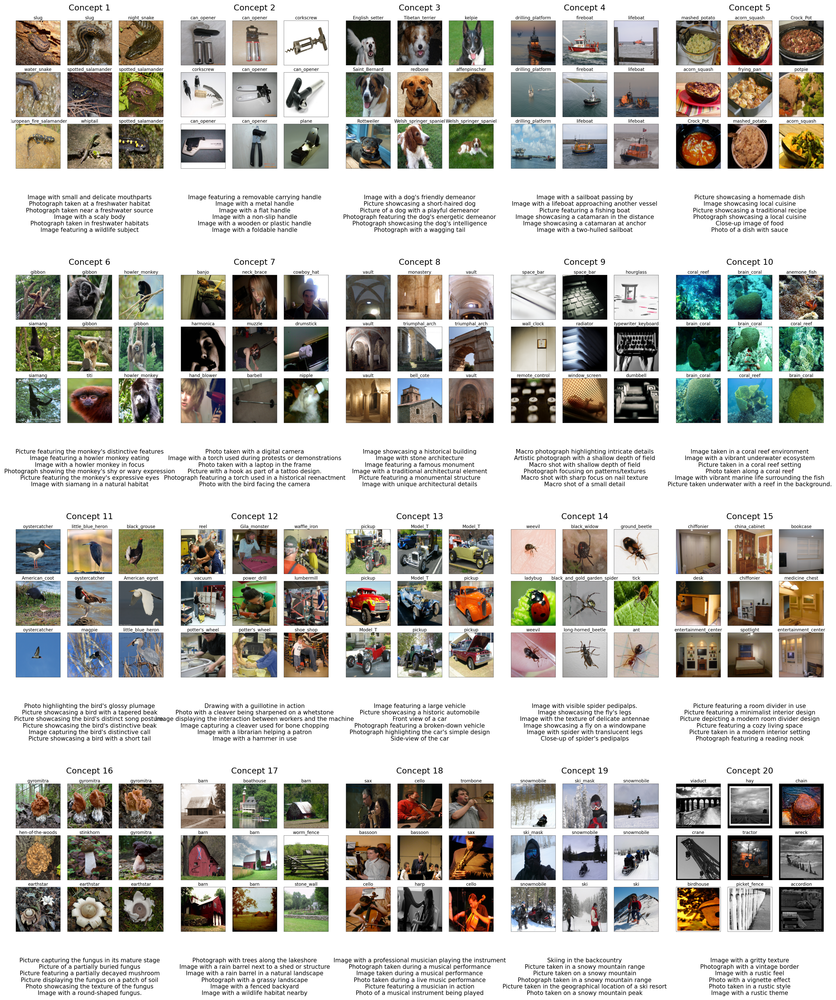

In [42]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# Project the text embeddings
projected_text_embedding = text_features @ Y_hat.T

# Get top positive and negative texts
top_texts, txt_scores = get_top_n_elements(csr_matrix(projected_text_embedding), n=10, axis=0)

fig, axs = plt.subplots(nrows=4, ncols=5, figsize=(25, 30), dpi=150)
axs = axs.flatten()  # Flatten the array to simplify indexing

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.05, hspace=0.2)  # Reduced spacing

# Loop over the range of clusters/images you have
for i in range(20):
    image_path = file_path + 'cluster_' + str(i + 1) + '.png'
    image = Image.open(image_path).convert("RGB")

    # Display image
    axs[i].imshow(np.array(image))
    axs[i].axis('off')  # Turn off axis

    description = "\n".join([concepts[txt] for txt in top_texts[i][:6]])
    
    # Set title or use text annotation inside the subplot
    axs[i].set_title(f'Concept {i + 1}', fontsize=14)
    axs[i].text(0.5, -0.15, description, va='top', ha='center', fontsize=10, transform=axs[i].transAxes)

# Remove tight_layout
# plt.tight_layout(pad=4.0)  # Commented out

plt.show()

## analogical relationship

In [43]:
for i in top_texts[36]:
    print(concepts[i])

Image with dogs in a group
Photograph capturing the essence of unity and togetherness
Image with multiple dogs
Crowded together
Photo with dogs interacting
Image with dogs playing
Group portrait
Photo with dogs resting
Picture depicting a cozy family gathering
Image featuring religious figures


In [44]:
multi_bird_concept = Y_hat[36]-Y_hat[2]+Y_hat[10]

In [45]:
multi_bird_concept.shape

(512,)

In [46]:
multi_bird_scores = image_features@multi_bird_concept

In [47]:
text_scores = text_features@multi_bird_concept

In [48]:
top_txt_values, top_txt_indices = torch.topk(text_scores, 10)

In [49]:
top_values, top_indices = torch.topk(multi_bird_scores, 9)

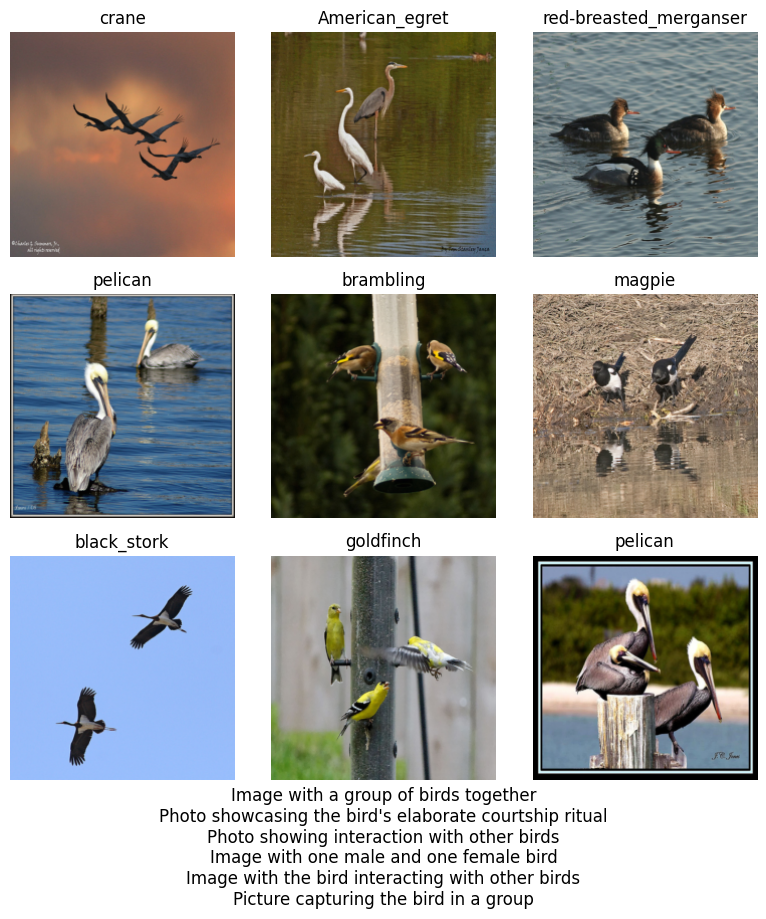

In [51]:
import matplotlib.pyplot as plt
def display_image(testset, img_idx, ax, title, wnid_to_class):
    image, label = testset[img_idx]  # Assuming 'testset' is accessible
    label = wnid_to_class[testset.classes[label]]
    title = label + title
    image = image.numpy()  # Convert to numpy array
    ax.imshow(np.transpose(image, (1, 2, 0)))  # Reorder dimensions for display
    ax.set_title(title, fontsize=12)  # Set the title for the subplot


plt.figure(figsize=(8, 8))  # Adjust the figure size as needed
for img_sub_idx in range(9):  # Iterate over the top n images for each cluster
    row = img_sub_idx // 3
    col = img_sub_idx % 3
    
    # Positive images
    ax_pos = plt.subplot(3, 3, img_sub_idx + 1)
    show_idx_pos = top_indices[img_sub_idx]  # Get the index for the current positive image
    display_image(raw_dataset, show_idx_pos, ax_pos, '', wnid_to_class)
    ax_pos.set_xticks([])  # Remove x-axis ticks
    ax_pos.set_yticks([])  # Remove y-axis ticks
    ax_pos.axis('off')  # Turn off axis for the subplot

# Create the description text (bottom of the figure)
description = "\n".join([concepts[txt] for txt in top_txt_indices[:6]])

# Add the text at the bottom of the whole figure
plt.figtext(0.5, 0.01, description, va='top', ha='center', fontsize=12)

# Display the final figure
plt.tight_layout()  # Adjust padding as necessary
plt.show()

## svd

In [53]:
Z_raw = U @ S_diag
sign_Z = np.diag(np.where(np.mean(Z_raw**3, axis=0) >= 0, 1, -1))
Z_raw = Z_raw @ sign_Z
Y_hat = sign_Z @ Vt

In [54]:
file_path = '/home/jitian/embedding_hc/imgs/clip/vit_b/raw_z_512d/'
plot_top_pos_images_per_cluster(Z_raw, raw_dataset, wnid_to_class, file_path, n=9, nrows=3, ncols=3)

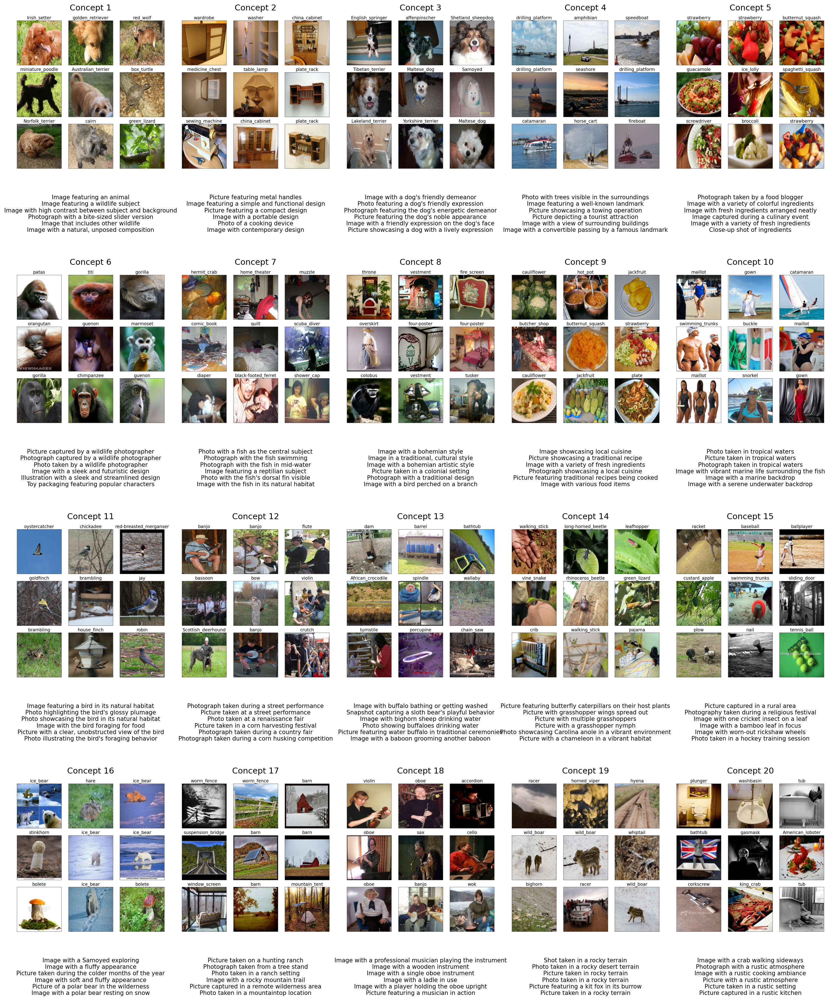

In [55]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
projected_text_embedding = text_features @ Y_hat.T

# Get top positive and negative texts
top_texts, txt_scores = get_top_n_elements(csr_matrix(projected_text_embedding), n=10, axis=0)

fig, axs = plt.subplots(nrows=4, ncols=5, figsize=(25, 30), dpi=150)
axs = axs.flatten()  # Flatten the array to simplify indexing

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.05, hspace=0.2)  # Reduced spacing

# Loop over the range of clusters/images you have
for i in range(20):
    image_path = file_path + 'cluster_' + str(i + 1) + '.png'
    image = Image.open(image_path).convert("RGB")

    # Display image
    axs[i].imshow(np.array(image))
    axs[i].axis('off')  # Turn off axis

    description = "\n".join([concepts[txt] for txt in top_texts[i][:6]])
    
    # Set title or use text annotation inside the subplot
    axs[i].set_title(f'Concept {i + 1}', fontsize=14)
    axs[i].text(0.5, -0.15, description, va='top', ha='center', fontsize=10, transform=axs[i].transAxes)

# Remove tight_layout
# plt.tight_layout(pad=4.0)  # Commented out

plt.show()

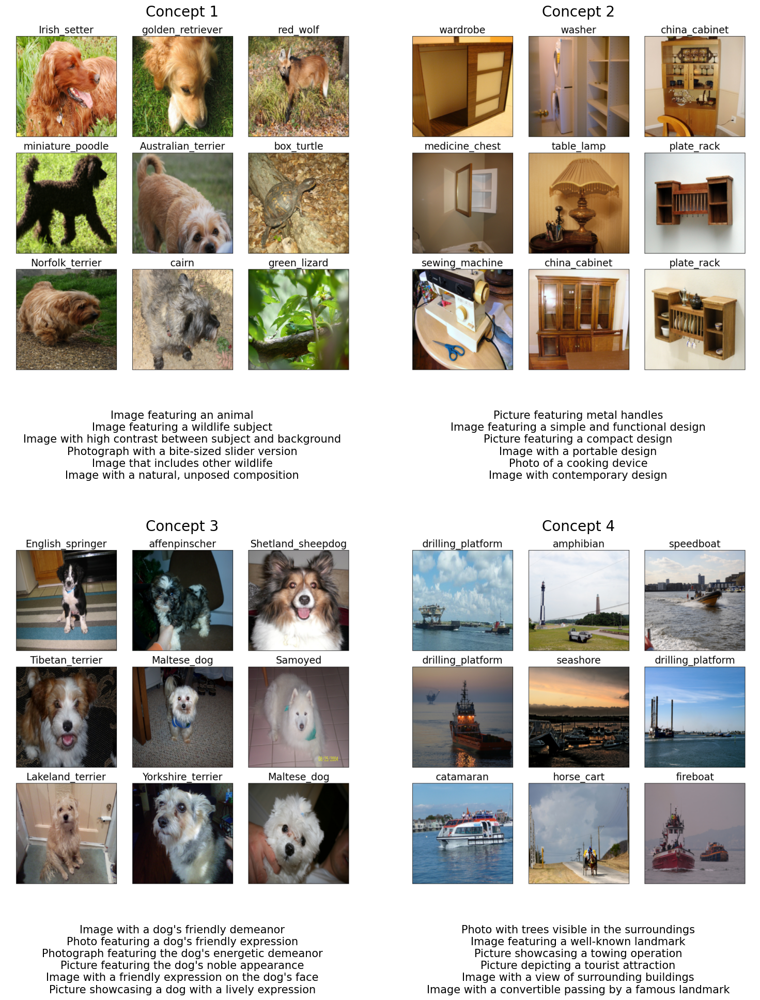

In [56]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# Assuming `text_embeddings` and `Y_hat` are already defined along with `get_top_n_elements`, `text_file_path`, and `file_path`.

# Project the text embeddings
projected_text_embedding = text_features @ Y_hat.T

# Get top positive and negative texts
top_texts, txt_scores = get_top_n_elements(csr_matrix(projected_text_embedding), n=10, axis=0)
top_neg_texts, neg_txt_scores = get_top_n_elements(csr_matrix(-projected_text_embedding), n=10, axis=0)

# Prepare the figure with a grid layout
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(16, 21))  # Adjust the size as needed
axs = axs.flatten()  # Flatten the array to simplify indexing

# Loop over the range of clusters/images you have
for i in range(4):
    image_path = file_path + 'cluster_' + str(i + 1) + '.png'
    image = Image.open(image_path).convert("RGB")

    # Display image
    axs[i].imshow(np.array(image))
    axs[i].axis('off')  # Turn off axis

    # Create text description combining top texts
    # description = "Top positive:\n" + "\n".join([lines[txt] for txt in top_texts[i]]) + \
    #               "\n------------------\nTop negative:\n" + "\n".join([lines[txt] for txt in top_neg_texts[i]])
    description = "\n".join([concepts[txt] for txt in top_texts[i][:6]])
    
    # Set title or use text annotation inside the subplot
    axs[i].set_title(f'Concept {i + 1}', fontsize=20)
    axs[i].text(0.5, -0.1, description, va='top', ha='center', fontsize=15, transform=axs[i].transAxes)

plt.tight_layout(pad=4.0)  # Adjust padding as necessary
plt.show()